In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("C:/Users/gustavo.gimenes/Desktop/database.csv")

# Remover possíveis duplicatas
df = df.drop_duplicates()

df

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.2460,145.6160,Earthquake,131.60,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.8630,127.3520,Earthquake,80.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.5790,-173.9720,Earthquake,20.00,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.0760,-23.5570,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.9380,126.4270,Earthquake,15.00,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23407,12/28/2016,08:22:12,38.3917,-118.8941,Earthquake,12.30,1.2,40.0,5.6,ML,...,18.0,42.47,0.120,NaN,0.1898,NN00570710,NN,NN,NN,Reviewed
23408,12/28/2016,09:13:47,38.3777,-118.8957,Earthquake,8.80,2.0,33.0,5.5,ML,...,18.0,48.58,0.129,NaN,0.2187,NN00570744,NN,NN,NN,Reviewed
23409,12/28/2016,12:38:51,36.9179,140.4262,Earthquake,10.00,1.8,NaN,5.9,MWW,...,NaN,91.00,0.992,4.8,1.5200,US10007NAF,US,US,US,Reviewed
23410,12/29/2016,22:30:19,-9.0283,118.6639,Earthquake,79.00,1.8,NaN,6.3,MWW,...,NaN,26.00,3.553,6.0,1.4300,US10007NL0,US,US,US,Reviewed


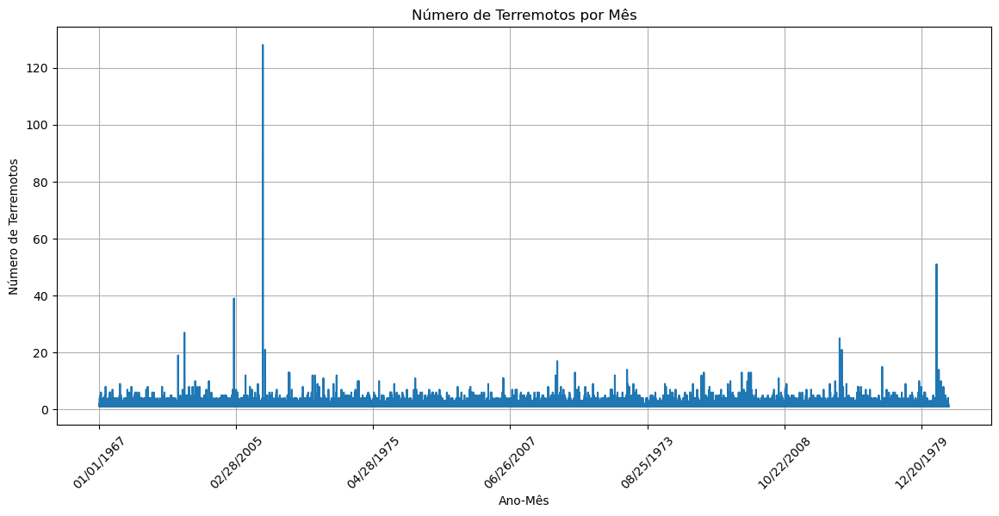

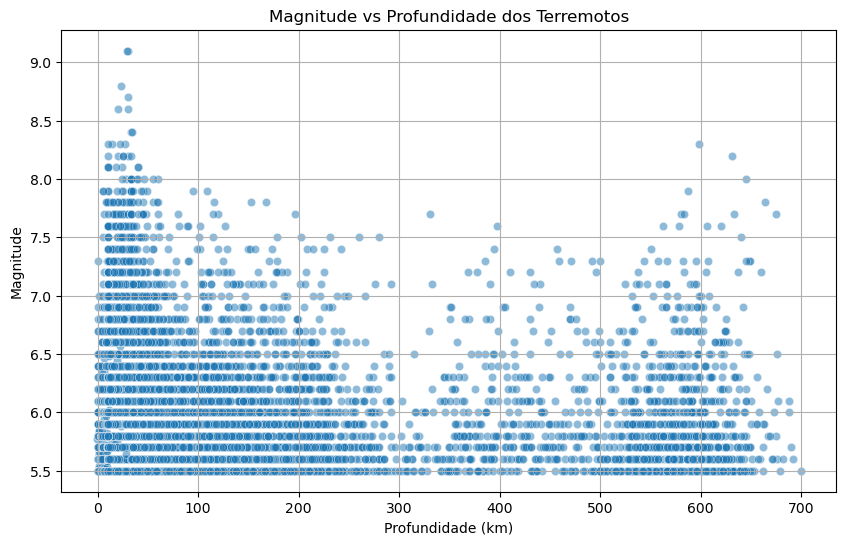

In [43]:
count_per_month = df.groupby('Date').size()

plt.figure(figsize=(14,6))
count_per_month.plot(kind='line')
plt.title('Número de Terremotos por Mês')
plt.xlabel('Ano-Mês')
plt.ylabel('Número de Terremotos')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

# Gráfico 2: magnitude vs profundidade
plt.figure(figsize=(10,6))
sns.scatterplot(data=df, x='Depth', y='Magnitude', alpha=0.5)
plt.title('Magnitude vs Profundidade dos Terremotos')
plt.xlabel('Profundidade (km)')
plt.ylabel('Magnitude')
plt.grid(True)
plt.show()

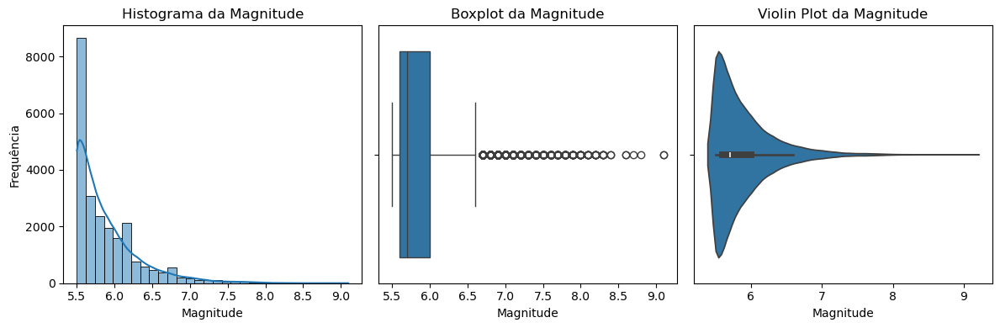

In [ ]:
# Histograma da magnitude
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
sns.histplot(df['Magnitude'], bins=30, kde=True)
plt.title('Histograma da Magnitude')
plt.xlabel('Magnitude')
plt.ylabel('Frequência')

# Boxplot da magnitude
plt.subplot(1,3,2)
sns.boxplot(x=df['Magnitude'])
plt.title('Boxplot da Magnitude')

# Violin plot da magnitude
plt.subplot(1,3,3)
sns.violinplot(x=df['Magnitude'])
plt.title('Violin Plot da Magnitude')

plt.tight_layout()
plt.show()


In [51]:
import folium

# Centralizar no centro aproximado dos dados
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]

m = folium.Map(location=map_center, zoom_start=2)

# Iterar apenas sobre linhas com latitude e longitude válidas
for idx, row in df.dropna(subset=['Latitude', 'Longitude']).iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        popup=f"Magnitude: {row['Magnitude']}",
        color='red',
        fill=True,
        fill_opacity=0.7
    ).add_to(m)

m.save('earthquake_map.html')


In [52]:
m

In [53]:
import folium
from folium.plugins import HeatMap

# Filtrar dados com lat/lon válidos
df_map = df.dropna(subset=['Latitude', 'Longitude'])

# Criar mapa centrado na média dos pontos
map_center = [df_map['Latitude'].mean(), df_map['Longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=2)

# Preparar dados para heatmap (lista de [lat, lon, peso])
# Pode usar magnitude como peso para dar intensidade maior a terremotos mais fortes
heat_data = [[row['Latitude'], row['Longitude'], row['Magnitude']] for idx, row in df_map.iterrows()]

# Adicionar HeatMap ao mapa
HeatMap(heat_data, radius=15, max_zoom=9).add_to(m)

# Salvar arquivo HTML
m.save('earthquake_heatmap.html')


In [54]:
m